In [1]:
import pandas as pd
import os
from matplotlib import pyplot as plt
import seaborn as sns
import math
import numpy as np
from sklearn.decomposition import PCA
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from scipy.stats import spearmanr
from sklearn.feature_selection import mutual_info_regression

I was given the following dataset

In [2]:
train_set = pd.read_csv('train.csv')
train_set.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 90000 entries, 0 to 89999
Data columns (total 54 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   0       90000 non-null  int64  
 1   1       90000 non-null  int64  
 2   2       90000 non-null  int64  
 3   3       90000 non-null  int64  
 4   4       90000 non-null  int64  
 5   5       90000 non-null  int64  
 6   6       90000 non-null  float64
 7   7       90000 non-null  float64
 8   8       90000 non-null  int64  
 9   9       90000 non-null  int64  
 10  10      90000 non-null  int64  
 11  11      90000 non-null  int64  
 12  12      90000 non-null  int64  
 13  13      90000 non-null  float64
 14  14      90000 non-null  float64
 15  15      90000 non-null  float64
 16  16      90000 non-null  float64
 17  17      90000 non-null  float64
 18  18      90000 non-null  float64
 19  19      90000 non-null  float64
 20  20      90000 non-null  float64
 21  21      90000 non-null  float64
 22

The dataset consists of 90000 instances, 53 variables, and a target. There are no missing values. All variables are numeric (if there were some categories, they were converted to numeric type). Let's take a closer look at some statistics and distributions.

In [3]:
train_set.iloc[:,:16].describe()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
count,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000
mean,249.423944,250.236267,248.637289,249.736600,249.436178,249.656167,-0.011402,0.498548,0.499189,249.842033,249.818967,249.346778,249.899900,7.483940,7.498037,7.496259
std,144.336393,144.022200,144.107577,144.284945,143.941581,144.329168,7.038171,0.288682,0.500002,144.612718,144.363827,144.476128,144.310495,4.330908,4.318388,4.338732
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-9.949874,0.000014,0.000000,0.000000,0.000000,0.000000,0.000000,0.000095,0.000252,0.000190
25%,125.000000,126.000000,124.000000,125.000000,125.000000,124.000000,-7.071068,0.248932,0.000000,124.000000,126.000000,124.000000,125.000000,3.723392,3.763626,3.718755
50%,250.000000,251.000000,248.000000,250.000000,250.000000,250.000000,0.000000,0.497136,0.000000,250.000000,250.000000,249.000000,251.000000,7.483265,7.505267,7.502682
75%,374.000000,375.000000,374.000000,375.000000,373.000000,374.000000,7.000000,0.747513,1.000000,376.000000,375.000000,375.000000,375.000000,11.242883,11.228331,11.258049
max,499.000000,499.000000,499.000000,499.000000,499.000000,499.000000,9.949874,0.999987,1.000000,499.000000,499.000000,499.000000,499.000000,14.999920,14.999938,14.999660


In [4]:
train_set.iloc[:,16:31].describe()

,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30
count,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000
mean,7.501635,7.486463,7.523043,7.475585,7.494835,7.503939,7.507724,7.508681,7.472421,7.519205,7.515753,7.509402,7.496781,7.504014,7.494212
std,4.345618,4.318031,4.323500,4.327327,4.325447,4.330159,4.332599,4.328966,4.345228,4.339104,4.333907,4.331007,4.334982,4.318553,4.327286
min,0.000192,0.000067,0.000229,0.000125,0.000382,0.000398,0.000140,0.000382,0.000129,0.000192,0.000017,0.000080,0.000161,0.000437,0.000041
25%,3.719537,3.758746,3.778857,3.733780,3.748951,3.760261,3.742810,3.768145,3.685140,3.760790,3.746467,3.772795,3.741697,3.774239,3.743116
50%,7.515240,7.467721,7.539462,7.460267,7.481500,7.521563,7.520793,7.520739,7.484349,7.526894,7.528984,7.494876,7.491009,7.500083,7.514475
75%,11.284618,11.238904,11.254751,11.211187,11.238128,11.248749,11.244657,11.240915,11.239795,11.276738,11.272683,11.271486,11.257988,11.233189,11.223296
max,14.999979,14.999840,14.999857,14.999634,14.999953,14.999483,14.999762,14.999875,14.999987,14.999651,14.999995,14.999838,14.999958,14.999841,14.999808


In [5]:
train_set.iloc[:,31:46].describe()

,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45
count,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000
mean,7.490808,7.486936,7.514508,7.491614,7.520193,7.507801,7.493713,7.513840,7.507033,7.479579,7.519826,7.502483,7.512965,7.475155,7.523962
std,4.322672,4.329524,4.329973,4.333144,4.335244,4.329515,4.327480,4.333543,4.327670,4.326175,4.315565,4.333881,4.329929,4.330410,4.321537
min,0.000070,0.000074,0.000111,0.000067,0.000078,0.000018,0.000094,0.000020,0.000106,0.000105,0.000273,0.000315,0.000060,0.000019,0.000040
25%,3.763061,3.750034,3.778028,3.743842,3.752848,3.776405,3.755325,3.754465,3.771945,3.731527,3.784809,3.763004,3.768044,3.707544,3.797002
50%,7.483334,7.458614,7.513794,7.475324,7.550623,7.484699,7.472789,7.518614,7.504101,7.452493,7.532363,7.511806,7.507058,7.474127,7.533987
75%,11.229486,11.245719,11.272623,11.241922,11.261178,11.255442,11.251097,11.270277,11.241504,11.222543,11.241135,11.255483,11.272459,11.216585,11.276349
max,14.999927,14.999896,14.999871,14.999558,14.999898,14.999997,14.999822,14.999958,14.999933,14.999704,14.999940,14.999739,14.999605,14.999900,14.999528


In [6]:
train_set.iloc[:,46:].describe()

,46,47,48,49,50,51,52,target
count,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000,90000.000000
mean,7.508397,7.473322,7.490658,7.474578,7.509206,7.487159,7.513316,50.033981
std,4.331761,4.335692,4.332122,4.323035,4.326364,4.324876,4.333080,28.897243
min,0.000154,0.000083,0.000367,0.000014,0.000160,0.000147,0.000125,0.002634
25%,3.760627,3.715721,3.739358,3.715298,3.773381,3.743536,3.776322,25.091903
50%,7.505259,7.459774,7.494167,7.477270,7.512575,7.476564,7.506812,50.030705
75%,11.261971,11.215637,11.239232,11.210070,11.268156,11.234414,11.277835,75.059454
max,14.999733,14.999478,14.999869,14.999928,14.999948,14.999364,14.999775,99.999482


There are 11 variables of integer type. One of them (var 8) is clearly a binary variable. The remaining 10 variables are discrete numeric variables. The rest of the dataset is of a float type which indicates continuous variables (including target). Judging by the basic statistics (mean, std, min, max, and quantiles), it becomes clear that some distributions are very similar, and probably were generated by the same rule (sampled from the same distribution) with the addition of some noise. The statistics are similar in the following groups: 0-5 and 9-12 (discrete), 13-52. Variable 6 is quite symmetric around 0. Let's see it visually.

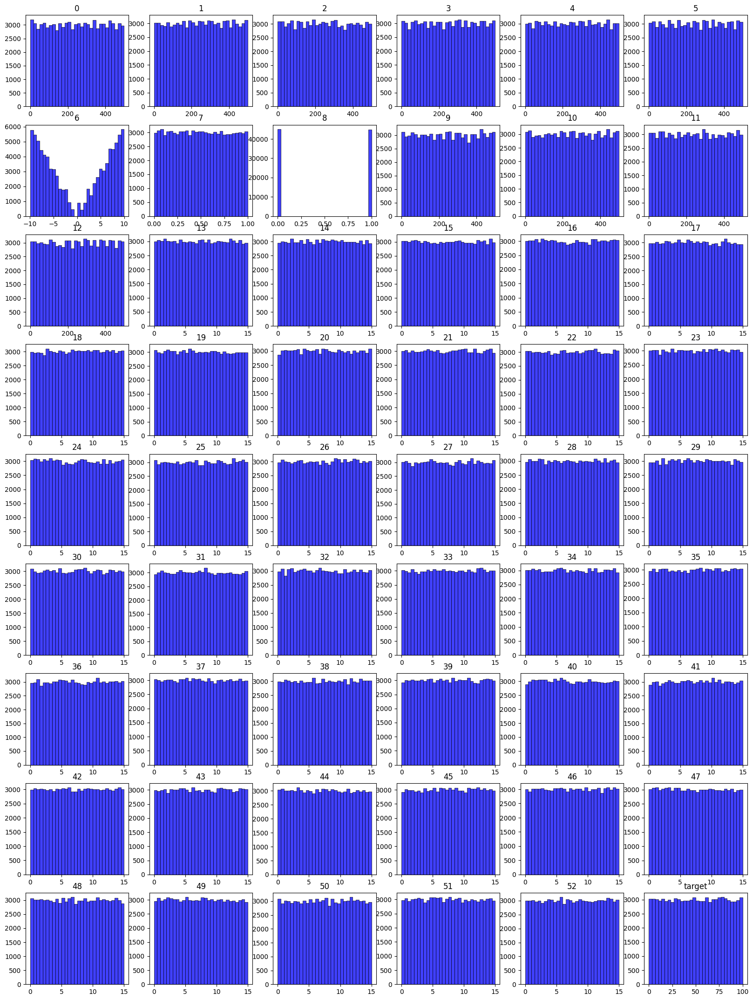

In [7]:
grid_cols = 6
grid_rows = math.ceil(train_set.shape[1] / grid_cols)
fig, axes = plt.subplots(grid_rows, grid_cols, figsize=(20, grid_rows * 3))
axes = axes.flatten()
for i, column in enumerate(train_set.columns):
    sns.histplot(train_set[column], kde=False, ax=axes[i], bins=30, color='blue')
    axes[i].set_title(column)
    axes[i].set_xlabel('')
    axes[i].set_ylabel('')
plt.show()

As was expected variable 6 is indeed symmetric around 0, and 8 is binary. The rest are uniformly distributed. There are no outliers. Since the number of points is huge which potentially slows down the analysis, I will take a random sample from the train set to make the following visualizations.

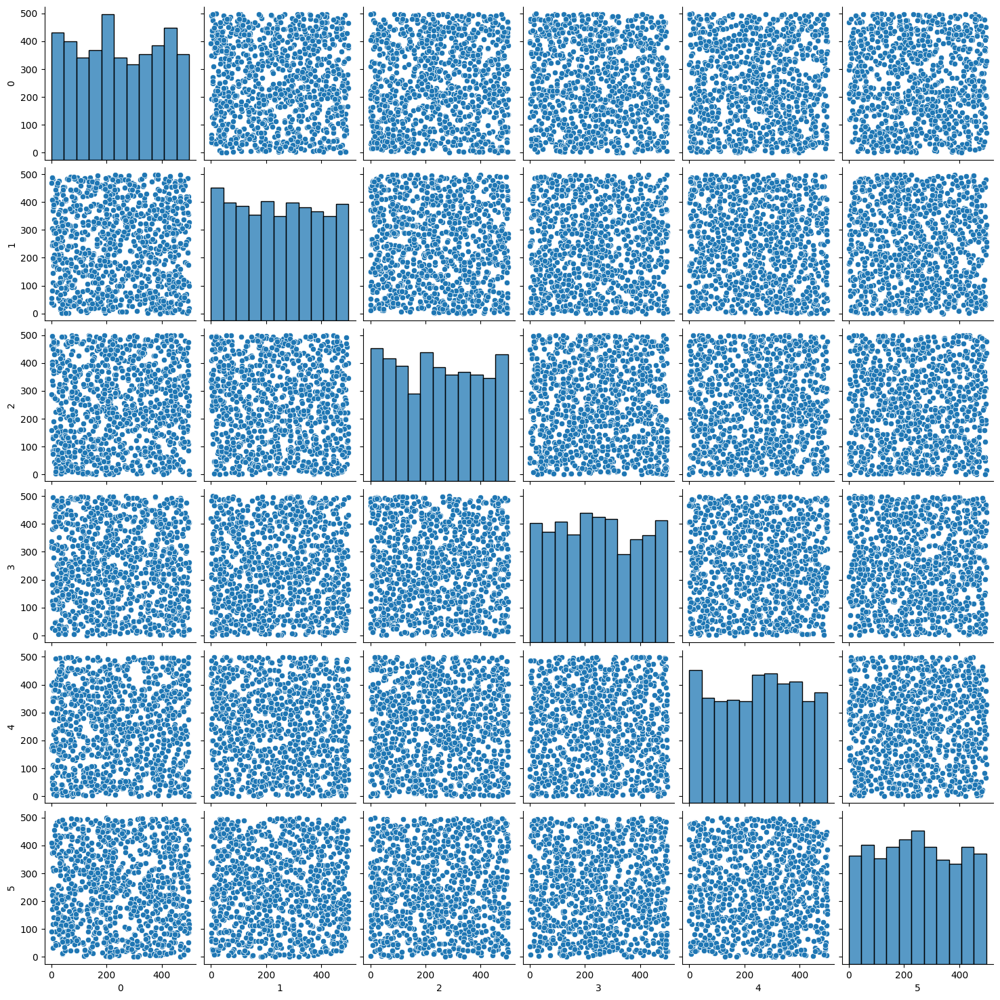

In [ ]:
sub = train_set.sample(n=1000, random_state=145)
sns.pairplot(sub.iloc[:, :6])
plt.show()

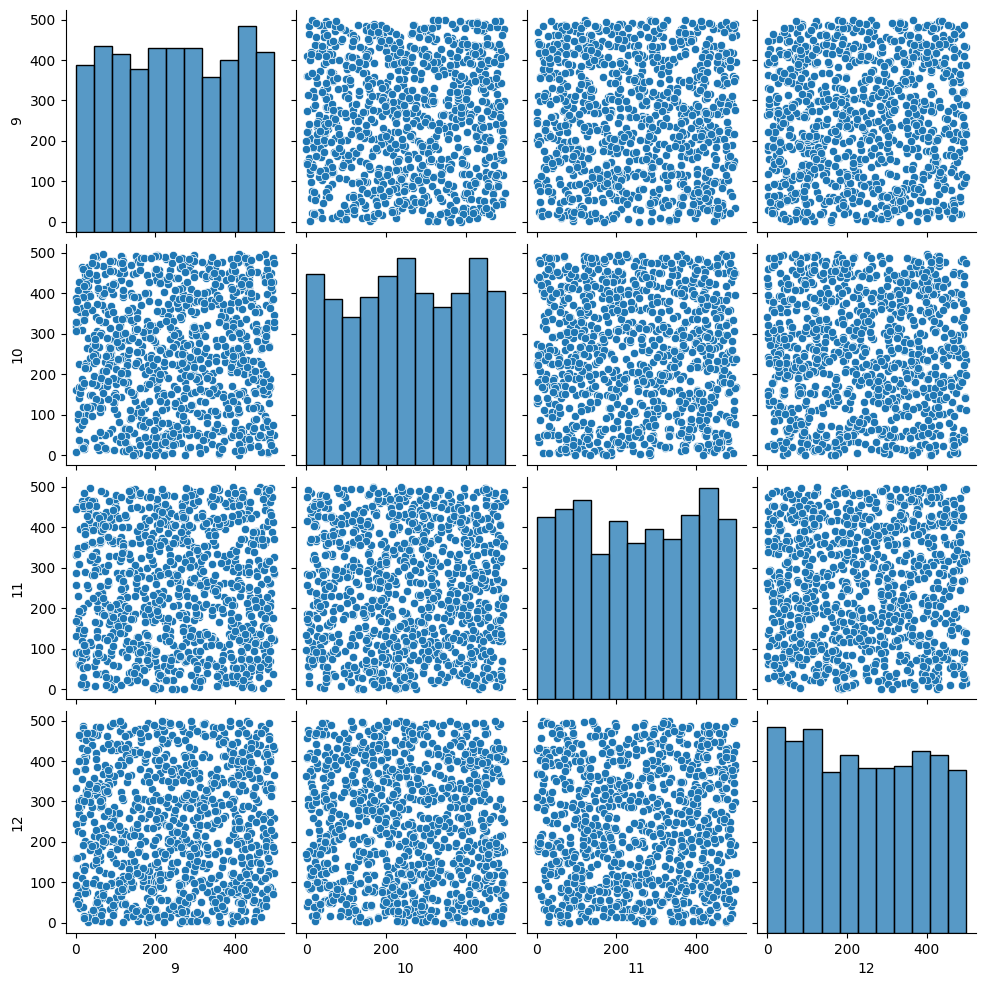

In [ ]:
sns.pairplot(sub.iloc[:, 9:13])
plt.show()

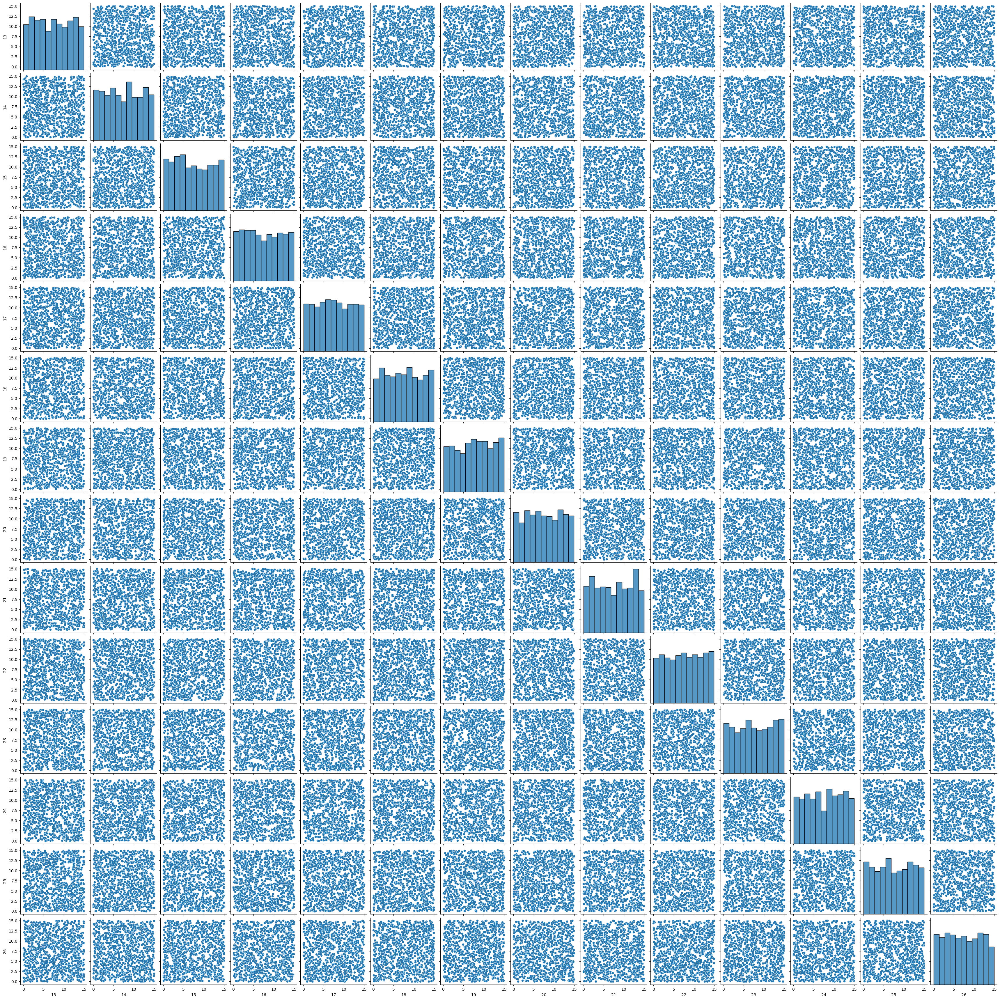

In [10]:
sns.pairplot(sub.iloc[:, 13:27])
plt.show()

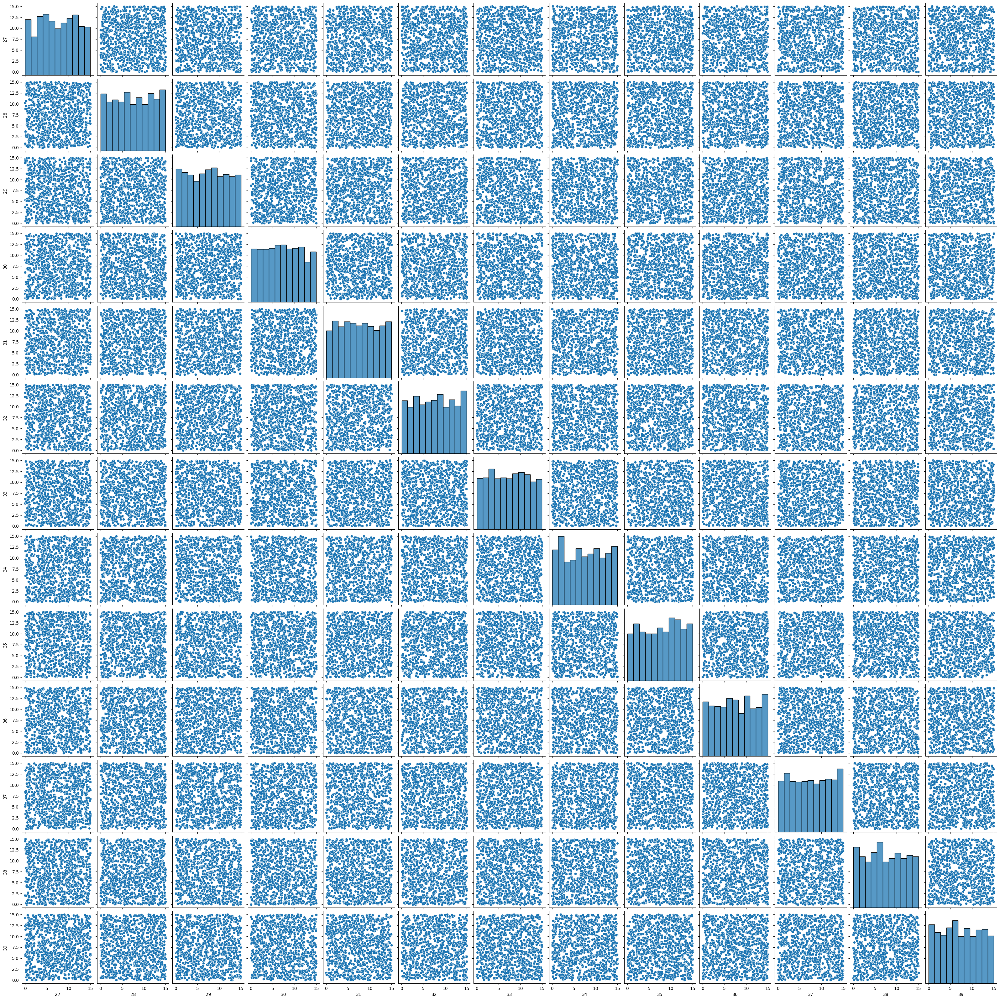

In [11]:
sns.pairplot(sub.iloc[:, 27:40])
plt.show()

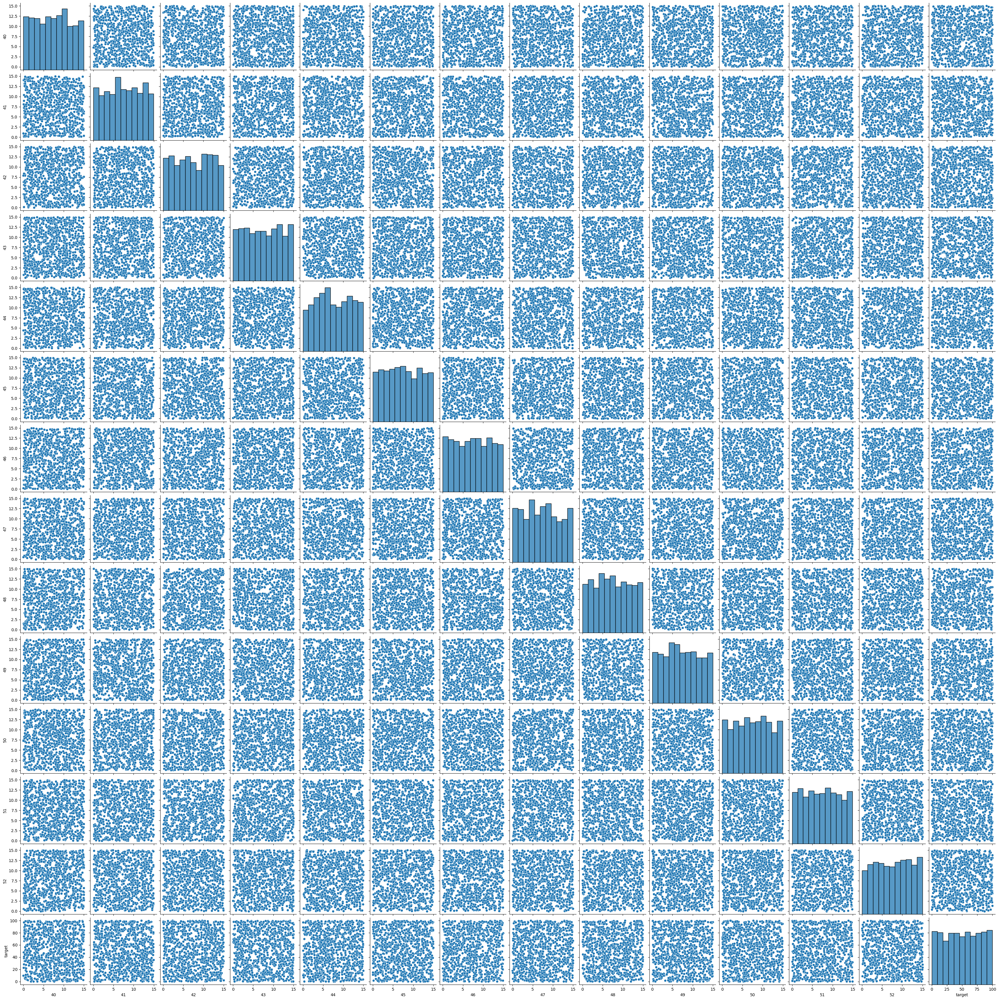

In [12]:
sns.pairplot(sub.iloc[:, 40:])
plt.show()

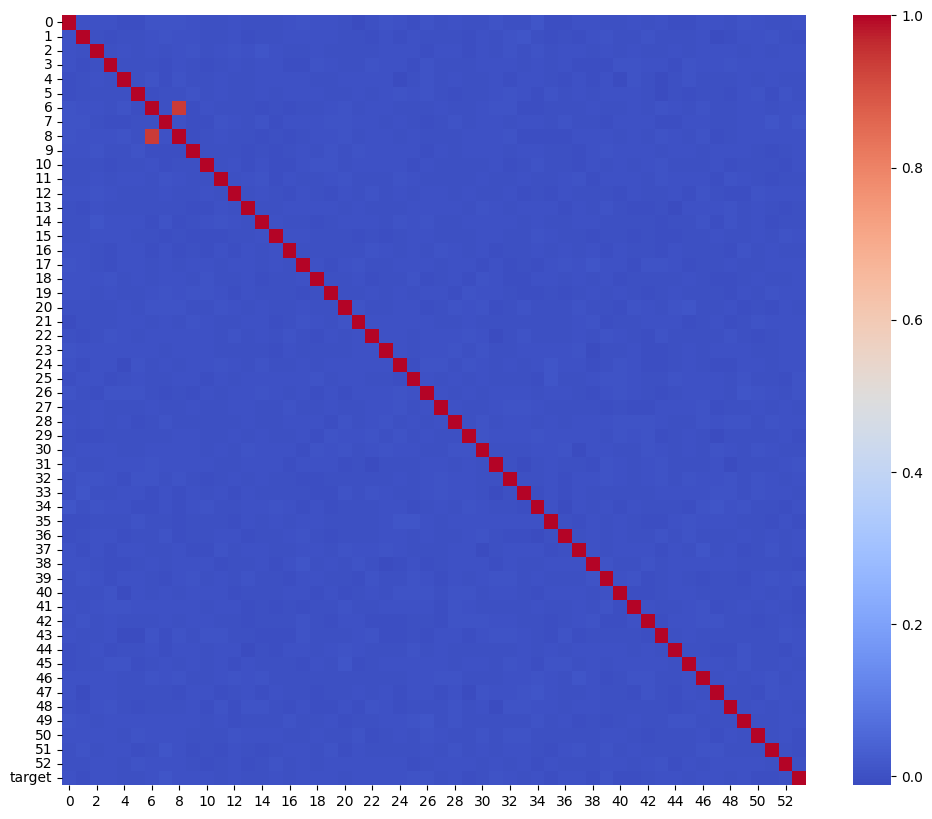

In [13]:
correlation_matrix = train_set.corr()
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=False, cmap='coolwarm')
plt.show()

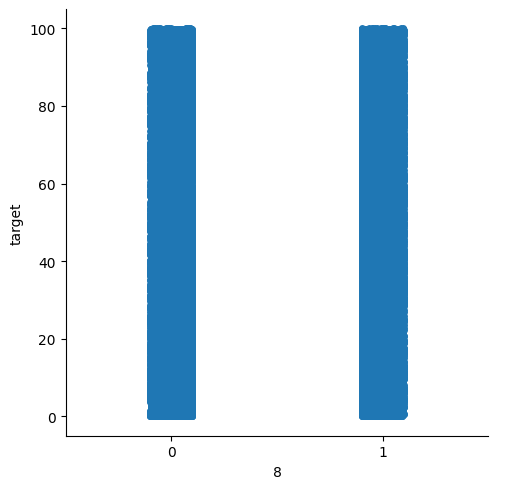

In [14]:
sns.catplot(data=train_set, x="8", y="target")

Even though there are some variables in the dataset that have very similar distributions, there is a very weak linear relationship between variables within those groups, meaning those variables are linearly independent. It still doesn't mean that there is no relation between them, it just indicates the absence of a linear relationship. There is also a very weak linear relationship between features and target. The only binary variable shows no influence on the target.

In [15]:
correlations = {col: spearmanr(train_set[col], train_set['target'])[0] for col in train_set.columns if col != 'target'}
print(correlations)

{'0': np.float64(0.0024205201908807338), '1': np.float64(-0.005550038575415792), '2': np.float64(0.0009919669284211639), '3': np.float64(0.0028108145909634995), '4': np.float64(-0.0012806727755215472), '5': np.float64(-0.002121307947966424), '6': np.float64(-0.0007596987131374966), '7': np.float64(0.012087856719286569), '8': np.float64(0.0003561746924107713), '9': np.float64(0.0015266800601145946), '10': np.float64(0.0033986236176379147), '11': np.float64(-0.0015609367018576856), '12': np.float64(0.0019957259494005277), '13': np.float64(-0.0010038621309716705), '14': np.float64(-0.0005058908044245957), '15': np.float64(0.001656561476220975), '16': np.float64(-0.0008388909722681759), '17': np.float64(0.0029657796251727304), '18': np.float64(0.0011911999357355394), '19': np.float64(0.0015198880715621263), '20': np.float64(-0.00042805091766601454), '21': np.float64(0.0028741318732931035), '22': np.float64(0.0003335419665267748), '23': np.float64(0.0012725095630871414), '24': np.float64(0.

There is also no monotonic relationship (Spearman correlation) between features and targets. All of this leads to conclusions: the linear ML techniques will be useless here; the feature set might have a lot of redundant information. I will fit PCA to see if I am right about redundancy and see what features are useful to predict target with Mutual Information (MI) value.

In [16]:
mi = mutual_info_regression(train_set.drop(columns=['target']), train_set['target'])
for i, col in enumerate(train_set.columns[:-1]):
    print(f"Feature: {col}, MI with target: {mi[i]:.3f}")

Feature: 0, MI with target: 0.001
Feature: 1, MI with target: 0.002
Feature: 2, MI with target: 0.004
Feature: 3, MI with target: 0.001
Feature: 4, MI with target: 0.000
Feature: 5, MI with target: 0.000
Feature: 6, MI with target: 4.602
Feature: 7, MI with target: 1.274
Feature: 8, MI with target: 0.000
Feature: 9, MI with target: 0.000
Feature: 10, MI with target: 0.000
Feature: 11, MI with target: 0.000
Feature: 12, MI with target: 0.008
Feature: 13, MI with target: 0.000
Feature: 14, MI with target: 0.000
Feature: 15, MI with target: 0.000
Feature: 16, MI with target: 0.002
Feature: 17, MI with target: 0.000
Feature: 18, MI with target: 0.001
Feature: 19, MI with target: 0.000
Feature: 20, MI with target: 0.000
Feature: 21, MI with target: 0.000
Feature: 22, MI with target: 0.005
Feature: 23, MI with target: 0.004
Feature: 24, MI with target: 0.000
Feature: 25, MI with target: 0.000
Feature: 26, MI with target: 0.001
Feature: 27, MI with target: 0.000
Feature: 28, MI with target: 0

It is quite interesting, it seems that only 2 variables have a significant impact on target prediction (variables 6 and 7).

I will split data into train/test sets

In [17]:
X = train_set.drop(columns=['target'])
Y = train_set['target']
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.1, random_state=4545)

In [18]:
pca = PCA()
principal_components = pca.fit_transform(X_train)
cumulative_variance = np.cumsum(pca.explained_variance_ratio_)
print(np.round(cumulative_variance, 4))

[0.1009 0.2015 0.3018 0.4017 0.5016 0.6013 0.7007 0.7995 0.8981 0.9962
 0.9964 0.9965 0.9966 0.9967 0.9968 0.9969 0.997  0.9971 0.9971 0.9972
 0.9973 0.9974 0.9975 0.9976 0.9977 0.9978 0.9979 0.998  0.9981 0.9981
 0.9982 0.9983 0.9984 0.9985 0.9986 0.9987 0.9988 0.9989 0.999  0.999
 0.9991 0.9992 0.9993 0.9994 0.9995 0.9996 0.9997 0.9997 0.9998 0.9999
 1.     1.     1.    ]


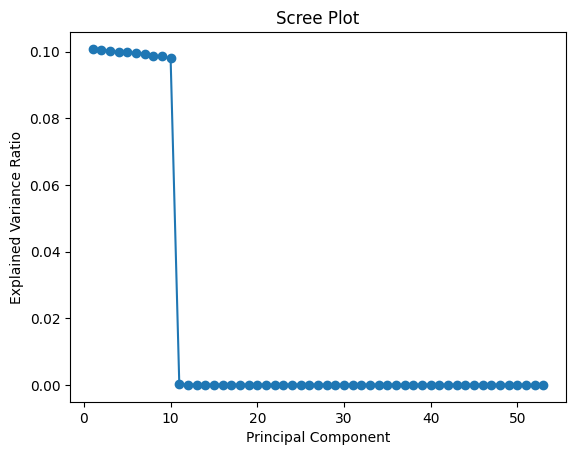

In [19]:
plt.plot(np.arange(1, len(pca.explained_variance_ratio_)+1), pca.explained_variance_ratio_, marker='o')
plt.xlabel('Principal Component')
plt.ylabel('Explained Variance Ratio')
plt.title('Scree Plot')
plt.show()

The data has indeed a lot of redundancy, almost 100% of variation can be explained with first 10 PC components. I will use those componnents to fit a model. Random Forest is chosen to perform the task (it captures nonlinear relationships, do not require data scaling, and is quite effective as all ensemble methods)

In [20]:
pca = PCA(n_components=10)
X_pca = pca.fit_transform(X_train)
model_rf = RandomForestRegressor(random_state=555)
model_rf.fit(X_pca, Y_train)

RandomForestRegressor(random_state=555)

See how good the prediction is on test set.

In [21]:
X_test_pca = pca.transform(X_test)
Y_pred = model_rf.predict(X_test_pca)
rmse = np.sqrt(mean_squared_error(Y_test, Y_pred))
rmse

np.float64(29.405304275993867)

The prediction is weak, let it be the benchmark. I will try fitting the same model on 2 variables that were said to contribute target prediction a lot.

In [22]:
model_mi = RandomForestRegressor(random_state=1515)
model_mi.fit(X_train[['6', '7']], Y_train)

RandomForestRegressor(random_state=1515)

In [23]:
Y_pred_mi = model_mi.predict(X_test[['6','7']])
rmse = np.sqrt(mean_squared_error(Y_test, Y_pred_mi))
rmse

np.float64(0.0014248160109477288)

Looks perfect (RMSE=0.0014). This model will be used for further prediction.